In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from scipy.stats import norm
import statistics as sta
import scipy.stats as stats
import json

## **Read data**

In [2]:
#read data
def result(year):
    path = "data/diemthi"+str(year)+".csv"     #path: sửa cái này để đọc data
    data = pd.read_csv(path, encoding = "Latin-1")
    data ['year'] = year
    return data
data = result(2021)
data

,Unnamed: 0,ID,CityCode,CityArea,Math,Literature,English,Physics,Chemistry,Biology,...,Civic Education,A,B,C,A1,D1,A-BK,A1-BK,Highest_combi,year
0,0,1000001,1,1.0,2.2,3.50,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,11.50,NaN,NaN,NaN,NaN,C,2021
1,1,1000002,1,1.0,9.2,8.25,10.0,NaN,NaN,NaN,...,9.25,NaN,NaN,23.75,NaN,27.45,NaN,NaN,D1,2021
2,2,1000003,1,1.0,4.4,6.25,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,14.50,NaN,NaN,NaN,NaN,C,2021
3,3,1000004,1,1.0,8.4,6.75,10.0,4.00,3.00,3.50,...,NaN,15.40,14.90,NaN,22.40,25.15,17.8500,23.1000,D1,2021
4,4,1000005,1,1.0,8.8,8.25,9.4,8.25,5.75,5.25,...,NaN,22.80,19.80,NaN,26.45,26.45,23.7000,26.4375,D1,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1002265,1021097,64006834,64,6.0,8.6,8.25,6.2,8.25,7.00,6.50,...,NaN,23.85,22.10,NaN,23.05,23.05,24.3375,23.7375,A,2021
1002266,1021098,64006835,64,6.0,9.0,7.50,9.4,8.00,8.25,5.50,...,NaN,25.25,22.75,NaN,26.40,25.90,25.6875,26.5500,A1,2021
1002267,1021099,64006836,64,6.0,4.8,7.00,4.6,NaN,NaN,NaN,...,9.00,NaN,NaN,17.75,NaN,16.40,NaN,NaN,C,2021
1002268,1021100,64006837,64,6.0,7.4,7.75,9.4,NaN,NaN,NaN,...,9.25,NaN,NaN,19.00,NaN,24.55,NaN,NaN,D1,2021


In [3]:
City = {1: "Hanoi", 2: "Ho Chi Minh City", 3: "Hai Phong",
        4: "Da Nang", 5: "Ha Giang", 6: "Cao Bang",
        7: "Lai Chau", 8: "Lao Cai", 9: "Tuyen Quang",
        10:"Lang Son", 11:"Bac Kan", 12:"Thai Nguyen",
        13:"Yen Bai", 14:"Son La", 15:"Phu Tho",
        16:"Vinh Phuc", 17:"Quang Ninh", 18:"Bac Giang",
        19:"Bac Ninh", 21:"Hai Duong",
        22:"Hung Yen", 23:"Hoa Binh", 24:"Ha Nam",
        25:"Nam Dinh", 26:"Thai Binh", 27:"Ninh Binh",
        28:"Thanh Hoa", 29:"Nghe An", 30:"Ha Tinh",
        31:"Quang Binh", 32:"Quang Tri", 33:"Thua Thien - Hue",
        34:"Quang Nam", 35:"Quang Ngai", 36:"Kon Tum",
        37:"Binh Dinh", 38:"Gia Lai", 39:"Phu Yen",
        40:"Dak Lak", 41:"Khanh Hoa", 42:"Lam Dong",
        43:"Binh Phuoc", 44:"Binh Duong", 45:"Ninh Thuan",
        46:"Tay Ninh", 47:"Binh Thuan", 48:"Dong Nai",
        49:"Long An", 50:"Dong Thap", 51:"An Giang",
        52:"Ba Ria - Vung Tau", 53:"Tien Giang", 54:"Kien Giang",
        55:"Can Tho", 56:"Ben Tre", 57:"Vinh Long",
        58:"Tra Vinh", 59:"Soc Trang", 60:"Bac Lieu",
        61:"Ca Mau", 62:"Dien Bien", 63:"Dak Nong", 64:"Hau Giang"}

AreaCode = {1: "Red River Delta", 2: "Northern midlands and mountain areas", 3:"North Central and Central coastal areas",
        4: "Central Highlands",
        5: "South East", 6: "Mekong River Delta"}

Area = {1:[1,3,16,19,22,21,26,25,24,27,17],
        2:[5,9,15,12,11,6,10,18,8,13,7,14,23,62],
        3:[28,29,30,31,32,33,4,34,35,37,39,41,45,47],
        4:[36,40,38,42,63],
        5:[2,52,44,43,46,48],
        6:[55,49,53,56,57,58,50,51,54,64,59,60,61]} 

## Candidate number of each province

In [4]:
def count_province(data):
    
    A = data['CityCode'].value_counts().sort_index()
    AreaSet = []
    for i in City.keys():
        for j in Area:
            if i in Area[j]:
                AreaSet.append(j)
    AreaName = [AreaCode[i] for i in AreaSet]
    CountTinh = {'CityCode':pd.Series(City.keys()),
                 'Province':pd.Series(City.values()),
                 'AreaCode': pd.Series(AreaSet),
                 'Area':pd.Series(AreaName),
                 'Count':pd.Series(list(A))}
    df = pd.DataFrame(CountTinh)
    fig = px.bar(df, x="Province", y="Count",barmode='group',color='Area',width=1000,height=600)
    fig.update_traces(width = 1)
    return fig

In [5]:
count_province(data)

## Candidate number based on highest subject combination

In [6]:
def count_combi(data):
    
    A = data['Highest_combi'].value_counts().sort_index()
    CountTinh = {'Highest_combi':pd.Series(['A','A1','B','C','D1']),
                 'Count':pd.Series(list(A))}
    df = pd.DataFrame(CountTinh)
    fig = px.bar(df, x='Highest_combi', y='Count', labels={'Count':'Participant number'})
    return fig

In [7]:
count_combi(data)

In [8]:
A = data[data.Highest_combi == 'D1']
B = A[A.Physics >= 0]
len(B)/len(A)

0.3164123114702008

## Score spectrum

### *Whole country*

In [9]:
def score_spectrum(data, subject):
    subject_name = ''
    if (len(subject)<3 or ('-' in subject)):
        bins = [i/2 for i in range(0,61)]
        data_show = data[subject].value_counts(bins = bins).sort_index()
        subject_name = 'Combination: '+subject
    else:
        data_show = data[subject].value_counts().sort_index()
        subject_name = subject
        
    count_score = {'Score': pd.Series((data_show.index).astype('str')),
               'Count': pd.Series(data_show.values)}
    
    df = pd.DataFrame(count_score)
    fig = px.bar(df, x='Score', y='Count',title=subject_name)
    return fig

In [10]:
score_spectrum(data,'D1')

### *City and Province*

In [11]:
def score_spectrum_province(data,subject,CityCode):

    data_province = data[data.CityCode == CityCode]
    subject_name = ''
    if (len(subject)<3 or ('-' in subject)):
        bins = [i/2 for i in range(0,61)]
        data_show = data_province[subject].value_counts(bins = bins).sort_index()
        subject_name = 'Combination: '+subject
    else:
        data_show = data_province[subject].value_counts().sort_index()
        subject_name = subject
        
    count_score = {'Score': pd.Series((data_show.index).astype('str')),
               'Count': pd.Series(data_show.values)}
    
    df = pd.DataFrame(count_score)
    fig = px.bar(df, x='Score', y='Count',title=City[CityCode]+': '+subject_name)
    return fig

In [12]:
score_spectrum_province(data,'English',1)

### *Area*

In [13]:
def score_spectrum_area(data,subject,CodeArea):
 
    data_province = data[data.CityArea == CodeArea]
    subject_name = ''
    if (len(subject)<3 or ('-' in subject)):
        bins = [i/2 for i in range(0,61)]
        data_show = data_province[subject].value_counts(bins = bins).sort_index()
        subject_name = 'Combination: '+subject
    else:
        data_show = data_province[subject].value_counts().sort_index()
        subject_name = subject
        
    count_score = {'Score': pd.Series((data_show.index).astype('str')),
               'Count': pd.Series(data_show.values)}
    
    df = pd.DataFrame(count_score)
    fig = px.bar(df, x='Score', y='Count',title=AreaCode[CodeArea]+': '+subject_name)
    return fig

In [14]:
score_spectrum_area(data,'English',3)

## Whole country score spectrum and Province score spectrum

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

def Spectrum_Compare(df, CityCode, mon_hoc):
    sns.set_theme()
    p1 = sns.kdeplot(df[mon_hoc], 
             color = 'darkblue', bw_adjust=2, legend = True, cut = 1)
        
    p2 = sns.kdeplot(df[df.CityCode==CityCode][mon_hoc], 
             color = 'red', bw_adjust=2, cut = 1)
    
    plt.legend(labels=['Whole country', City[CityCode]])
    # Khai báo tiêu đề cho trục x
    plt.xlabel('Exam result: '+mon_hoc)
    # Khai báo tiêu đề cho trục y
    plt.ylabel('Exam result density distribution')
    plt.rcParams['figure.figsize'] = (20, 7)

    plt.show()

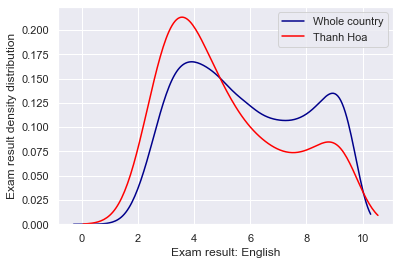

In [16]:
Spectrum_Compare(data, 28, 'English')

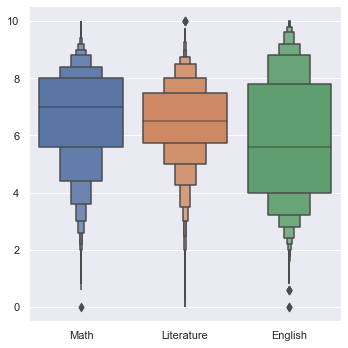

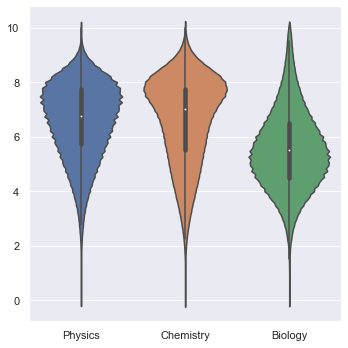

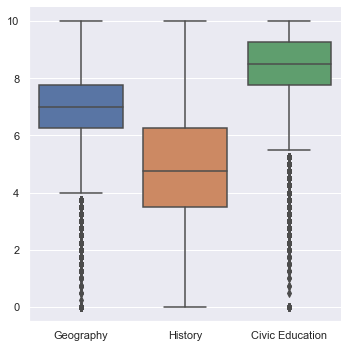

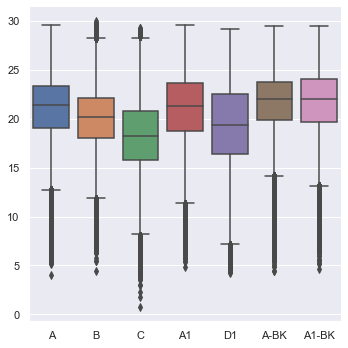

In [17]:
sns.catplot(data = data.loc[:,data.columns[4:7]], kind = 'boxen',dodge=False)
sns.catplot(data = data.loc[:,data.columns[7:10]], kind = 'violin',dodge=False)
sns.catplot(data = data.loc[:,data.columns[10:13]], kind = 'box',dodge=False)
sns.catplot(data = data.loc[:,data.columns[13:20]], kind = 'box',dodge=False)
plt.show()

## Area score spectrum 

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns

def SoSanhVung(data, AreaSet, mon_hoc):
    sns.set_theme()
    p1 = sns.kdeplot(data[mon_hoc], 
             color = 'darkblue', bw_adjust=2, legend = True, cut = 1)
    for i in AreaSet:
        sns.kdeplot(data[data.CityArea==i][mon_hoc], bw_adjust=2, cut = 1)
    
    plt.legend(labels=['Whole country']+[AreaCode[i] for i in AreaSet])
    # Khai báo tiêu đề cho trục x
    plt.xlabel('Exam result: '+mon_hoc)
    # Khai báo tiêu đề cho trục y
    plt.ylabel('Exam result density distribution')
    plt.rcParams['figure.figsize'] = (20, 7)
    
    plt.show()

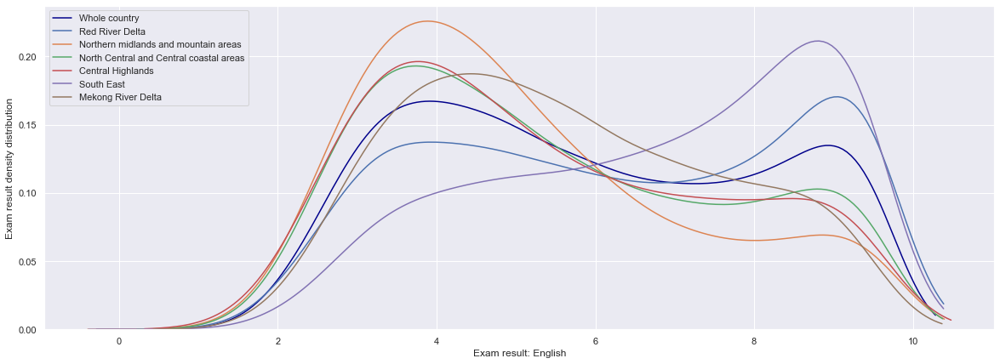

In [19]:
SoSanhVung(data, [1,2,3,4,5,6], 'English')

## Subject score spectrum

In [20]:
def SoSanhPhoMon(data, mon_hoc):
    for i in mon_hoc:
        p1 = sns.kdeplot(data[i], 
             bw_adjust=2, 
             legend = True,
             color=mon_hoc[i],
             cut = 1)
    
    plt.legend(labels=mon_hoc)
    # Khai báo tiêu đề cho trục x
    plt.xlabel('Exam result:')
    # Khai báo tiêu đề cho trục y
    plt.ylabel('Exam result density distribution')
    plt.show()

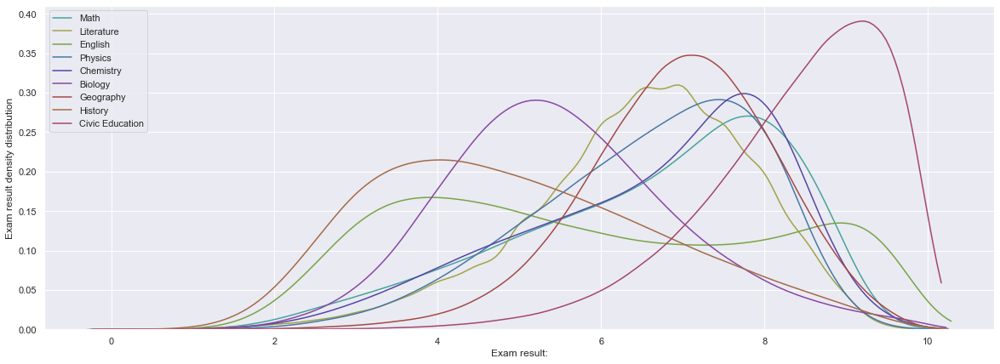

In [21]:
mon_hoc = {"Math": "#45a39b", 
           "Literature": "#a0a345", 
           "English":"#77a345" , 
           "Physics":"#4577a3", 
           "Chemistry":"#5145a3", 
           "Biology": "#8845a3", 
           "Geography":"#a34845", 
           "History":"#a36a45", 
           "Civic Education":"#a3456a"}
SoSanhPhoMon(data,mon_hoc)

## score spectrum year to year

In [22]:
def SoSanhPhoNam(year, mon_hoc):
    for i in year:
        data1 = result(i)

        p1 = sns.kdeplot(data1[mon_hoc], 
             bw_adjust=2,
             legend = True,
             cut = 1)
    
    plt.legend(labels=year)
    # Khai báo tiêu đề cho trục x
    plt.xlabel('Exam result: '+ mon_hoc)
    # Khai báo tiêu đề cho trục y
    plt.ylabel('Exam result density distribution')
    plt.savefig(mon_hoc+'.png')
    plt.show()

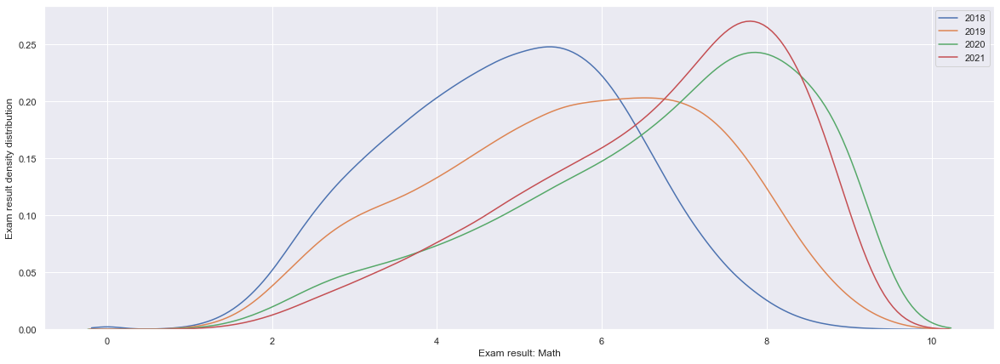

In [23]:
SoSanhPhoNam([2018,2019,2020,2021], 'Math')

In [24]:
path = "D:/pythonProject/DS capstone project/data/Province_Avg2021.csv"
Province_Avg_Score = pd.read_csv(path, encoding = "Latin-1")

## Scatter plot

In [25]:
Combo_data = {'A': data[data.Highest_combi == "A"],
'A1': data[data.Highest_combi == "A1"],
'B': data[data.Highest_combi == "B"],
'C': data[data.Highest_combi == "C"],
'D1': data[data.Highest_combi == "D1"]}

In [26]:
Combo = {"A":["Math", "Physics", "Chemistry"],
         "B":["Math", "Chemistry", "Biology"],
         "C":["Literature","History","Geography"],
         "D1":["Math","Literature","English"],
         "A1":["Math","English","Physics"]
}

In [27]:
def Scatter(Combo, subject):
    X = list(Combo_data[Combo][subject])
    Y = list(Combo_data[Combo][Combo])
    
    fig = px.scatter(data_frame=Combo_data[Combo],x=subject,y=Combo,width=600,height=600)
    
    fig.show()
    print('Pearson correlation:',stats.pearsonr(X,Y)[0])
    print('Spearman correlation:',stats.spearmanr(X,Y)[0])

In [28]:
Scatter('A1','Math')

Pearson correlation: 0.8180867949870909
Spearman correlation: 0.7870674707312136


In [29]:
def HighLow(Combi,mini,subject):
    A = data[data['Highest_combi'] == Combi]
    B = A[A[Combi]>=mini]

    high = len(B[B[subject]>(B[Combi]/3+0.5)])
    low = len(B[B[subject]<(B[Combi]/3-0.5)])
    med = len(B)-high-low
    
    return [high, med, low]

def HighLowDict(Combi,mini):
    df = {'Subject':[Combo[Combi][0]]*3+[Combo[Combi][1]]*3+[Combo[Combi][2]]*3,
          'Type': ['High','Medium','Low']*3,
          'Count': HighLow(Combi,mini,Combo[Combi][0])+HighLow(Combi,mini,Combo[Combi][1])+HighLow(Combi,mini,Combo[Combi][2])
    }
    return pd.DataFrame(df)

def HighLowFig(Combi, mini):
    df = HighLowDict(Combi,mini)
    fig = px.bar(df, x="Subject", y="Count", color="Type", title='Combination: '+Combi)
    fig.show()

In [30]:
''' The plot shows the affect of subject to combination:
High: the number of score of subject is greater than one-third of combination score plus 0.5
Low: the number of score of subject is greater than one-third of combination score minus 0.5
Medium: the remain number of score'''

HighLowFig('A',20)

## Chart of each year

In [31]:
bigData = pd.concat([result(2021),result(2020),result(2019),result(2018)])

In [32]:
bigData

,Unnamed: 0,ID,CityCode,CityArea,Math,Literature,English,Physics,Chemistry,Biology,...,Civic Education,A,B,C,A1,D1,A-BK,A1-BK,Highest_combi,year
0,0,1000001,1,1.0,2.2,3.50,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,11.50,NaN,NaN,NaN,NaN,C,2021
1,1,1000002,1,1.0,9.2,8.25,10.0,NaN,NaN,NaN,...,9.25,NaN,NaN,23.75,NaN,27.45,NaN,NaN,D1,2021
2,2,1000003,1,1.0,4.4,6.25,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,14.50,NaN,NaN,NaN,NaN,C,2021
3,3,1000004,1,1.0,8.4,6.75,10.0,4.00,3.00,3.50,...,NaN,15.40,14.90,NaN,22.40,25.15,17.8500,23.1000,D1,2021
4,4,1000005,1,1.0,8.8,8.25,9.4,8.25,5.75,5.25,...,NaN,22.80,19.80,NaN,26.45,26.45,23.7000,26.4375,D1,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
921902,925728,64006212,64,6.0,5.4,8.25,5.0,NaN,NaN,NaN,...,7.75,NaN,NaN,18.75,NaN,18.65,NaN,NaN,C,2018
921903,925729,64006213,64,6.0,6.8,8.75,5.0,5.00,4.50,3.75,...,NaN,16.30,15.05,NaN,16.80,20.55,17.3250,17.7000,D1,2018
921904,925730,64006214,64,6.0,6.2,8.25,3.8,6.00,6.25,6.00,...,NaN,18.45,18.45,NaN,16.00,18.25,18.4875,16.6500,A,2018
921905,925731,64006215,64,6.0,6.8,7.00,2.2,6.25,6.75,4.00,...,NaN,19.80,17.55,NaN,15.25,16.00,19.9500,16.5375,A,2018


### *Participant number year to year*

In [33]:
def count_year():
    A = bigData['year'].value_counts().sort_index()
    CountYear = {'year':pd.Series(A.index.astype('str')),
                 'Count':pd.Series(A.values)}
    df = pd.DataFrame(CountYear)
    fig = px.bar(df, x='year', y='Count', labels={'Count':'Participant number'})
    return fig

In [34]:
count_year()

### *Stacked Area Chart*

In [35]:
def count_range(data,subject,mini,maxi):
    df1 = data[data[subject] >= mini]
    df2 = df1[df1[subject] <= maxi]
    return len(df2)

In [36]:
import plotly.graph_objects as go

def AreaStack(subject):
    BigData = {2018: result(2018),
               2019: result(2019),
               2020: result(2020),
               2021: result(2021)}

    r1 = [count_range(BigData[2018+i],subject,0,5.1) for i in range(4)]
    r2 = [count_range(BigData[2018+i],subject,5.2,7.1) for i in range(4)]
    r3 = [count_range(BigData[2018+i],subject,7.2,8.0) for i in range(4)]
    r4 = [count_range(BigData[2018+i],subject,8.1,10) for i in range(4)]

    x=[2018,2019,2020,2021]
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=x, y=r1,
        mode='lines',
        line=dict(width=0.5, color='rgb(190, 87, 12)'),
        stackgroup='one',
        name = '0 - 5.1',
        groupnorm='percent' # sets the normalization for the sum of the stackgroup
    ))
    fig.add_trace(go.Scatter(
        x=x, y=r2,
        mode='lines',
        line=dict(width=0.5, color='rgb(225, 105, 180)'),
        name = '5.2 - 7.1',
        stackgroup='one'
    ))
    fig.add_trace(go.Scatter(
        x=x, y=r3,
        mode='lines',
        line=dict(width=0.5, color='rgb(255, 220, 70)'),
        name = '7.2 - 8.0',
        stackgroup='one'
    ))
    fig.add_trace(go.Scatter(
        x=x, y=r4,
        mode='lines',
        line=dict(width=0.5, color='rgb(255, 10, 40)'),
        name = '8.1 - 10',
        stackgroup='one'
    ))

    fig.update_layout(
        showlegend=True,
        xaxis_type='category',
        yaxis=dict(
            type='linear',
            range=[1, 100],
            ticksuffix='%'),
        title = subject,
        legend_title = 'Score_range')

    fig.show()

In [37]:
AreaStack('Math')

## Clustering province based on English distribution

In [38]:
D = data[data['CityCode']==60]
E = D[D['English'] >= 0]['English']

In [39]:
Left = []
Right = []
Med = []
for i in City:
    D = data[data['CityCode']==i]
    E = D[D['English'] >= 0]['English']
    if stats.skew(E) > 0.2:
        Left.append(i)
    elif stats.skew(E) < -0.2:
        Right.append(i)
    else:
        Med.append(i)
print(Left)
print(Right)
print(Med)

[5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 18, 22, 23, 28, 29, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 43, 45, 46, 49, 50, 54, 56, 58, 59, 61, 62, 63, 64]
[1, 2, 3, 4, 44, 52]
[16, 17, 19, 21, 24, 25, 26, 27, 37, 41, 42, 47, 48, 51, 53, 55, 57, 60]


## Correlation

In [40]:
M = data[data['Math']>=0]
P = M[M['Physics']>=0]
Q = P[P['Physics']>=8.5]

In [41]:
print(stats.pearsonr(P['Math'],P['Physics']))
print(stats.spearmanr(P['Math'],P['Physics']))

(0.5943609804295731, 0.0)
SpearmanrResult(correlation=0.5882727656665806, pvalue=0.0)


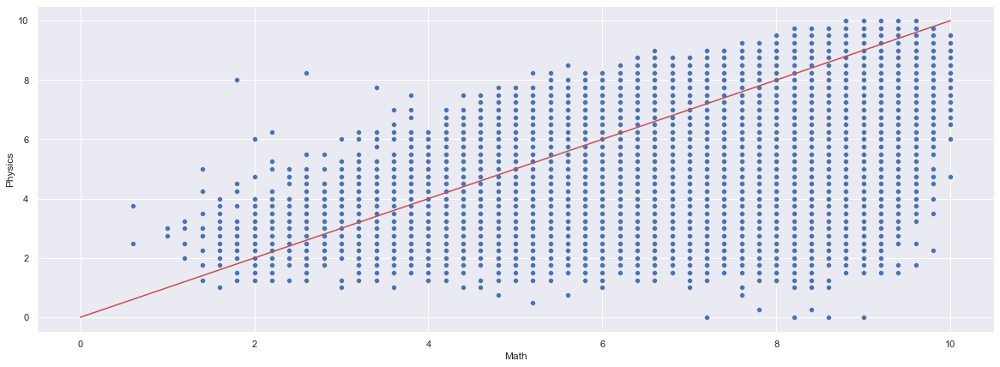

In [42]:
sns.scatterplot(x = 'Math',y = 'Physics',data = P)
plt.rcParams['figure.figsize'] = (8,8)
plt.plot([0,10],[0,10],'r')
plt.show()

### *Hypothesis testing*

Sample: Math score of 100 participants whose Physics score is greater or equal 8.

In [43]:
# Score spectrum of Math score of participants whose Physics score is greater or equal 8.
score_spectrum(data[data['Math']>=9],'Physics')

In [44]:

def MeanStd(data, subject):
    res = []
    for i in data[subject]:
        if i>=0:
            res.append(i)
    mean = sta.mean(res)
    stdev = sta.stdev(res)
    return [mean, stdev]

# Mean, std of data 
MeanStd(data[data['Math']>=9],'Physics')

[7.727144604187795, 1.091695307484447]

In [45]:
# Sample of 100 participant.

df100 = data[data['Physics']>=8].sample(1000)
score_spectrum(df100,'Math').show()
print(MeanStd(df100,'Math'))

[8.5726, 0.5201921182023425]


In [46]:
def P_testing(df, subject1, subject2, ny0, alpha = 0.05, min_score = 8, n = 100):

    dfN = df[df[subject1]>=min_score].sample(n)
    
    mean = MeanStd(dfN, subject2)[0]
    s = MeanStd(dfN, subject2)[1]

    zc = (mean - ny0)/(s/n**0.5)
    p_value = 2*norm.cdf(zc)
    
    if zc > 0:
        p_value = 2*norm.cdf(-zc)
    else:
        p_value = 2*norm.cdf(zc)
    
    print(mean)
    print(s)
    print('====== HYPOTHESIS ======')
    print('H0: mean =',ny0)
    print('H1: mean !=',ny0)
    print('******** RESULT ********')
    if p_value < alpha:
        print('Reject H0')
    else:
        print('Accept H0')
    print('p-value:', p_value)

In [47]:
P_testing(df = data, subject1='Physics', subject2='Math', ny0=8.6, alpha=0.05, min_score=8, n=1000)

8.58
0.5112547128207049
====== HYPOTHESIS ======
H0: mean = 8.6
H1: mean != 8.6
******** RESULT ********
Accept H0
p-value: 0.21606279199435252


## Choropleth map

In [48]:
def Choropleth_VN_2020(feature):

    ProvinceInfo = pd.read_excel('data/ProvinceInfo.xlsx')
    #Vietnam map
    vietnam_geo = json.load(open("data/vietnam_state.geojson","r"))

    # Plotting
    fig = px.choropleth_mapbox(
        data_frame = ProvinceInfo,
        locations = 'CityCode',
        featureidkey='properties.Code',
        geojson = vietnam_geo,
        color = feature,
        hover_name = "CityName",
        mapbox_style = "carto-positron",
        center = {"lat": 16,"lon": 106},
        zoom = 4.5,
        title = "Vietnam Economy and Social map",
        color_continuous_scale=px.colors.diverging.Tealrose,

        width= 800,
        height=1000)
    fig.update_geos(fitbounds = "locations", visible=False)
    return fig

In [49]:
ProvinceInfodf = pd.read_excel('data/ProvinceInfo.xlsx')
ProvinceInfodf

,CityName,CityCode,Area,Monthly Income,Province Specialized Schools,Ethnic Pupils Ratio (%),Students/ Teacher,Urban Ratio,Poverty Rate,Covid 19
0,Hà Nội,1,1,6205.45,8,2.12,21.93,49.25,0.4904,14421
1,Vĩnh Phúc,16,1,4289.92,1,10.48,21.73,29.97,2.4838,2862
2,Bắc Ninh,19,1,5439.20,1,4.39,15.20,31.47,0.7058,46267
3,Quảng Ninh,17,1,4539.47,1,0.16,19.82,64.44,2.1335,81
4,Hải Dương,21,1,4388.45,1,0.33,21.13,32.22,1.8446,1579
...,...,...,...,...,...,...,...,...,...,...
58,Cần Thơ,55,6,5031.09,1,3.38,17.63,70.02,1.9760,13
59,Hậu Giang,64,6,3974.29,1,3.08,19.38,27.97,5.5990,1
60,Sóc Trăng,59,6,3635.02,1,27.15,16.29,32.33,4.9784,4
61,Bạc Liêu,60,6,3338.48,1,7.79,23.37,27.88,6.6718,51


In [51]:
Choropleth_VN_2020('Ethnic Pupils Ratio (%)')